# Guide to analyzing ENEM data

This notebook contains code to guide the user on how to visualize and analyze the ENEM data downloaded by ```../scraper/scrape_inep.py```. In order to execute this script the user needs to install all the python libraries listed in the ```../requirements.txt``` in the root of this repo.


## Table of Contents
- [1. Downloading the data](#download)
    - [1.1. Download ENEM data](#enem)
    - [1.2. Download shapefiles](#shape)
- [2. Organizing the data](#organize)
- [3. Visualize the data](#viz)
    - [3.1. Map](#map)
    - [3.2. Graphs](#graph)
- [4. Next steps](#next)

<a name="download"></a>
## 1. Downloading ENEM data

We begin by downloading the necessary data in order to visualize and analyze ENEM data. This means running two scripts that can be found in ```../scrape```. The first downloads ENEM data and the second downloads the necessary shapefiles in order to plot a map. Please note that this data will be stored in the folders ```../data/enem``` and ```../data/shapefiles``` respectively.

<a name="enem"></a>
### 1.1. Download ENEM data

In order to download ENEM data please run the following:

In [ ]:
%run -i "../scraper/scrape_inep.py"

This script will download data all ENEM data between 2009 and 2019. The results will be saved as ```.csv``` files in the ```../data/enem``` folder. For this notebook we will only use data from the ```../data/enem/enem_2019.csv``` file.

<a name="enem"></a>
### 1.2. Download shapefiles

We will need shapefiles in order to properly plot the data we downloaded in section [1.1.](#enem) above. To download these files, run the followin:

In [ ]:
%run -i "../scraper/scrape_shp.py"

The final data with all the necessary shapefiles will be saved in the folder ```../data/shapefiles```. We will need this in order to produce the plots in section [3.1.](#map) below.

<a name="organize"></a>
## 2. Organizing the data

Before we can proceed and visualize the data, we need to organize it. This also gives a chance to look at what data is available in our dataset. We can begin by importing the necessary libraries for this script.

In [1]:
# Import necessary libraries
import imageio
import geopandas as gpd
import math, os
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from IPython.display import Image
from matplotlib import colors

Our data will be stored as the variabla ```enem_2019```.

In [ ]:
enem_2019 = pd.read_csv("../data/enem/enem_2019.csv", sep = ";", encoding = "utf-8")

In [ ]:
# Take a look at the first few rows
pd.options.display.max_columns = None
enem_2019.head()

The variables we will need for this notebook are the following:
    - NU_INSCRICAO
    - NU_ANO
    - CO_MUNICIPIO_RESIDENCIA
    - CO_UF_RESIDENCIA
    - SG_UF_RESIDENCIA
    - NU_IDADE
    - TP_SEXO
    - TP_ESTADO_CIVIL
    - TP_COR_RACA
    - CO_MUNICIPIO_NASCIMENTO
    - CO_UF_NASCIMENTO
    - SG_UF_NASCIMENTO
    - TP_ST_CONCLUSAO
    - TP_ANO_CONCLUIU
    - TP_ESCOLA
    - TP_ENSINO
    - IN_TREINEIRO
    - CO_ESCOLA
    - CO_MUNICIPIO_ESC
    - CO_UF_ESC
    - SG_UF_ESC
    - TP_DEPENDENCIA_ADM_ESC
    - TP_LOCALIZACAO_ESC
    - TP_SIT_FUNC_ESC
    - CO_MUNICIPIO_PROVA
    - CO_UF_PROVA
    - SG_UF_PROVA
    - NU_NOTA_CN
    - NU_NOTA_CH
    - NU_NOTA_LC
    - NU_NOTA_MT
    - NU_NOTA_REDACAO
    
So we can proceed by only keeping these variables

In [ ]:
# Set relevant variables
relevant_var = ["NU_INSCRICAO", "NU_ANO", "CO_MUNICIPIO_RESIDENCIA", "CO_UF_RESIDENCIA",
                "SG_UF_RESIDENCIA", "NU_IDADE", "TP_SEXO", "TP_ESTADO_CIVIL", "TP_COR_RACA",
                "CO_MUNICIPIO_NASCIMENTO", "CO_UF_NASCIMENTO", "SG_UF_NASCIMENTO", "TP_ST_CONCLUSAO",
                "TP_ANO_CONCLUIU", "TP_ESCOLA", "TP_ENSINO", "IN_TREINEIRO", "CO_ESCOLA", "CO_MUNICIPIO_ESC",
                "CO_UF_ESC", "SG_UF_ESC", "TP_DEPENDENCIA_ADM_ESC", "TP_LOCALIZACAO_ESC", "TP_SIT_FUNC_ESC",
                "CO_MUNICIPIO_PROVA", "CO_UF_PROVA", "SG_UF_PROVA", "NU_NOTA_CN", "NU_NOTA_CH",
                "NU_NOTA_LC", "NU_NOTA_MT", "NU_NOTA_REDACAO"]
# Keep only relevant variables
enem_2019 = enem_2019[relevant_var]

Now we import the shapefiles using geopandas

In [2]:
# Read shapefiles with geopandas
brazil_map = gpd.read_file("../data/shapefiles/BR_Municipios_2019.shp")
# Set variable for municipality codes as integer to match later
brazil_map["CD_MUN"] = brazil_map["CD_MUN"].astype(int)

We will need to organize the data in order to make the maps we want.

<a name="viz"></a>
## 3. Visualize the data

This section will generate some graphs and maps in order to better understand the data. All the plots will be saved in the folder ```../figures``` in the root folder.

<a name="map"></a>
### 3.1. Map

Let's plot one map for grades in each subject for all municipalities. The functions in this sections can be tweaked to make different maps. We can define a function to plot the maps

In [3]:
# Define function to map grades for each municipality
def plot_map(df, map_df, subject):
    """
    This function defines the parameters to plot a map for a given subject category for each
    municipality in Brazil.
    """
    # Set variable for subject argument
    if subject == "natural_sciences":
        var = "NU_NOTA_CN"
        label = "Natural Sciences"
    elif subject == "humanities":
        var = "NU_NOTA_CH"
        label = "Humanities"
    elif subject == "languages":
        var = "NU_NOTA_LC"
        label = "Languages"
    elif subject == "math":
        var = "NU_NOTA_MT"
        label = "Mathematics"
    elif subject == "writing":
        var = "NU_NOTA_REDACAO"
        label = "Writing"
    # Set plot map by joining dataframes
    plot_map = map_df.set_index("CD_MUN").join(df[["CO_MUNICIPIO_RESIDENCIA", var]].groupby("CO_MUNICIPIO_RESIDENCIA", as_index = False).mean().set_index("CO_MUNICIPIO_RESIDENCIA"))
    # Get values for colorbar
    vmin, vmax, vcenter = int(math.floor(plot_map[var].min()/100.0))*100, int(math.ceil(plot_map[var].max()/100.0))*100, int(math.floor(plot_map[var].min()/100.0))*100 + (int(math.ceil(plot_map[var].max()/100.0))*10 - int(math.floor(plot_map[var].min()/100.0))*10)/2
    divnorm = colors.DivergingNorm(vmin = vmin, vcenter = vcenter, vmax = vmax)
    # Create normalized colorbar
    col_pal = "Blues"
    cbar = plt.cm.ScalarMappable(norm=divnorm, cmap = col_pal)
    # Plot subplots and maps
    fig, ax = plt.subplots(1,figsize=(10, 8)) 
    plt.tight_layout()
    plot_map.plot(ax = ax, color = 'grey') # Fill non-available grey
    plot_map.plot(column = var, cmap = col_pal, ax = ax)
    # Specify title depending on category
    plt.title("Distribution of {} exam grades".format(label), weight = "bold", fontsize = 16, pad = 20)
    # Graph specifications
    plt.annotate("Source: Ministry of Education, Brazil", xy = (0.05, 0.03),  xycoords = "figure fraction", horizontalalignment = "left", verticalalignment = "top", fontsize = 12, color = "#555555")
    fig.colorbar(cbar, ax = ax, shrink = 0.8)
    ax.set_axis_off()
    # Save plot
    plt.savefig("../figures/enem_{}_2019.png".format(label.lower()))

In [ ]:
plot_map(enem_2019,brazil_map,"math")

We can proceed to look at the data available for covid infections and deaths

In [4]:
# Read covid data
covid_df = pd.read_csv("../data/covid/caso_full.csv", encoding = "utf-8")

In [5]:
# Look at first few rows
covid_df.head()

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths
0,São Paulo,3550308.0,2020-02-25,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-25,0.0,0,1,city,SP,1,0
1,NaN,35.0,2020-02-25,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-25,0.0,0,1,state,SP,1,0
2,São Paulo,3550308.0,2020-02-26,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-26,0.0,0,2,city,SP,0,0
3,NaN,35.0,2020-02-26,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-26,0.0,0,2,state,SP,0,0
4,São Paulo,3550308.0,2020-02-27,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-27,0.0,0,3,city,SP,0,0


We can keep only the necessary columns and eliminate the rows with null values for cities as they refer to states

In [6]:
# Set list with necessary columns
keep_columns= ["city", "city_ibge_code", "date", "epidemiological_week", "estimated_population",
               "is_last", "is_repeated", "last_available_confirmed", "last_available_deaths",
               "last_available_confirmed_per_100k_inhabitants", "last_available_death_rate",
               "place_type", "state", "new_confirmed", "new_deaths"]
# Keep only relevant variables
covid_df = covid_df[keep_columns]
# Keep only data for cities
covid_df = covid_df[covid_df.place_type == "city"]
# Create log-scaled variables
covid_df["log_cases"] = covid_df["last_available_confirmed_per_100k_inhabitants"].apply(lambda x: np.log(x+1))
covid_df["log_last_available_cases"] = covid_df["last_available_confirmed"].apply(lambda x: np.log(x+1))
covid_df["log_last_available_deaths"] = covid_df["last_available_deaths"].apply(lambda x: np.log(x+1))
covid_df["log_death_rate"] = covid_df["last_available_death_rate"].apply(lambda x: np.log(x+1))
covid_df["log_new_confirmed"] = covid_df["new_confirmed"].apply(lambda x: np.log(x+1))
covid_df["log_new_deaths"] = covid_df["new_deaths"].apply(lambda x: np.log(x+1))
# Change date format
covid_df["date"] = pd.to_datetime(covid_df["date"]).dt.strftime("%B %d, %Y")

In [7]:
covid_df

,city,city_ibge_code,date,epidemiological_week,estimated_population,is_last,is_repeated,last_available_confirmed,last_available_deaths,last_available_confirmed_per_100k_inhabitants,...,place_type,state,new_confirmed,new_deaths,log_cases,log_last_available_cases,log_last_available_deaths,log_death_rate,log_new_confirmed,log_new_deaths
0,São Paulo,3550308.0,"February 25, 2020",9,12325232.0,False,False,1,0,0.00811,...,city,SP,1,0,0.008077,0.693147,0.000000,0.000000,0.693147,0.0
2,São Paulo,3550308.0,"February 26, 2020",9,12325232.0,False,False,1,0,0.00811,...,city,SP,0,0,0.008077,0.693147,0.000000,0.000000,0.000000,0.0
4,São Paulo,3550308.0,"February 27, 2020",9,12325232.0,False,False,1,0,0.00811,...,city,SP,0,0,0.008077,0.693147,0.000000,0.000000,0.000000,0.0
6,São Paulo,3550308.0,"February 28, 2020",9,12325232.0,False,False,2,0,0.01623,...,city,SP,1,0,0.016100,1.098612,0.000000,0.000000,0.693147,0.0
8,São Paulo,3550308.0,"February 29, 2020",9,12325232.0,False,False,2,0,0.01623,...,city,SP,0,0,0.016100,1.098612,0.000000,0.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1107234,Tocantínia,1721109.0,"November 23, 2020",48,7617.0,False,True,420,5,5513.98188,...,city,TO,0,0,8.615224,6.042633,1.791759,0.011830,0.000000,0.0
1107235,Tupirama,1721257.0,"November 23, 2020",48,1922.0,False,True,101,2,5254.94277,...,city,TO,0,0,8.567115,4.624973,1.098612,0.019607,0.000000,0.0
1107236,Tupiratins,1721307.0,"November 23, 2020",48,2729.0,False,True,18,0,659.58226,...,city,TO,0,0,6.493122,2.944439,0.000000,0.000000,0.000000,0.0
1107237,Wanderlândia,1722081.0,"November 23, 2020",48,11734.0,False,True,383,5,3264.01909,...,city,TO,0,0,8.091021,5.950643,1.791759,0.013015,0.000000,0.0


Now we can use a function similar to the one we used for ENEM data in order to plot a map of cases for each city in Brazil

In [8]:
# Define function to map grades for each municipality
def plot_covid(df, map_df, day, var):
    """
    This function defines the parameters to plot a map for covid cases in a given week 
    available for each municipality in Brazil.
    """
    # Define labels
    if var == "log_cases":
        label = "confirmed cases per 100k inhabitants"
    elif var == "log_last_available_cases":
        label = "confirmed cases"
    elif var == "log_last_available_deaths":
        label = "Number of deaths"
    elif var == "log_death_rate":
        label = "death rate"
    elif var == "log_new_confirmed":
        label = "new confirmed cases"
    elif var == "log_new_deaths":
        label = "new deaths"
    # Set dataframe for given week
    df_ = df[df.date == day]
    # Set plot map by joining dataframes
    plot_map = map_df.set_index("CD_MUN").join(df_[["city_ibge_code", var]].groupby("city_ibge_code", as_index = False).mean().set_index("city_ibge_code"))
    # Get values for colorbar
    vmin, vmax, vcenter = round(df[var].min(), 5), round(df[var].max(), 5), (round(df[var].max(), 5) - round(df[var].min(), 5))/2
    divnorm = colors.DivergingNorm(vmin = vmin, vcenter = vcenter, vmax = vmax)
    # Create normalized colorbar
    col_pal = "Blues"
    cbar = plt.cm.ScalarMappable(norm=divnorm, cmap = col_pal)
    # Plot subplots and maps
    fig, ax = plt.subplots(1,figsize=(10, 8)) 
    plt.tight_layout()
    plot_map.plot(ax = ax, color = 'grey') # Fill non-available grey
    plot_map.plot(column = var, cmap = col_pal, ax = ax)
    # Specify title depending on category
    plt.title("Log of {}".format(label), weight = "bold", fontsize = 16, pad = 20)
    # Graph specifications
    plt.annotate("{}".format(str(day)), xy = (0.05, 0.4), xycoords = 'figure fraction', horizontalalignment = 'left', verticalalignment = 'top', fontsize = 14, weight = 800)
    fig.colorbar(cbar, ax = ax, shrink = 0.8)
    ax.set_axis_off()
    # Save plot
    plt.savefig("../figures/covid_{}_{}.png".format(var, str(day).replace(" ", "_")))

Now we do the following in order to plot graphs for all the available dates and to combine them as a gif

In [10]:
dates = covid_df["date"].unique().tolist()

In [12]:
var_ = "log_cases"

for x in dates:
    plot_covid(covid_df, brazil_map, x, var_)
    plt.close()

In [23]:
files = ["../figures/covid_log_cases_{}.png".format(file.replace(" ","_")) for file in covid_df["date"].unique()]

In [25]:
# Read with imageio
images = [imageio.imread(file) for file in files]

In [28]:
# Save gif
imageio.mimwrite('../figures/covid_map.gif', images, fps = 8)

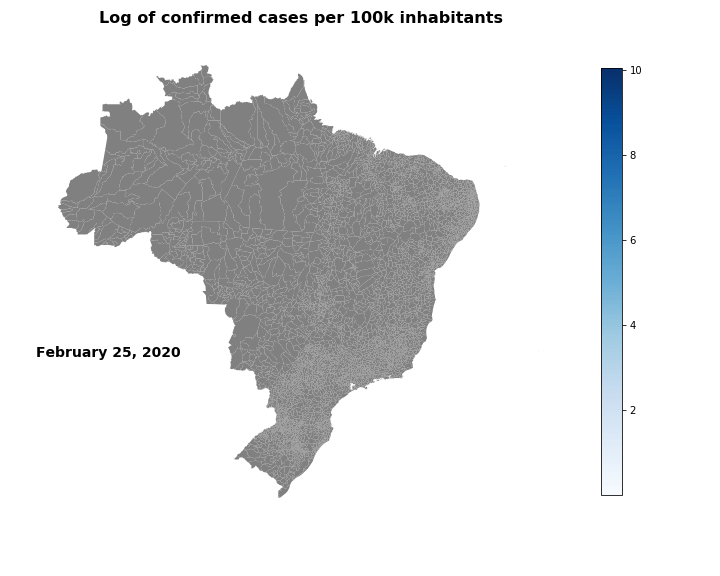

In [29]:
# Plot gif for all respondents
Image(open('../figures/covid_map.gif','rb').read())